# Visualizing the parcellations 

In [1]:
import os
import numpy as np
from cneuromod_embeddings.dypac_utils import get_root_data, load_dypac
from cneuromod_embeddings.repro_summary import load_repro, visu_match
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import matplotlib.cm as cm

xp_type = 'friends-s02'
root_data = get_root_data(f'data/{xp_type}')
root_results = get_root_data(f'results/{xp_type}')
root_models = get_root_data('models/')
fwhm = 5
cluster = 256
state = 1024
subject = 'sub-03'
file_anat = os.path.join(root_models, f"{subject}_space-MNI152NLin2009cAsym_desc-preproc_T1w.nii.gz")

model, mask_img = load_dypac(subject=subject, root_data=root_data, fwhm=fwhm, cluster=cluster, state=state, batch="training", xp_type=xp_type)


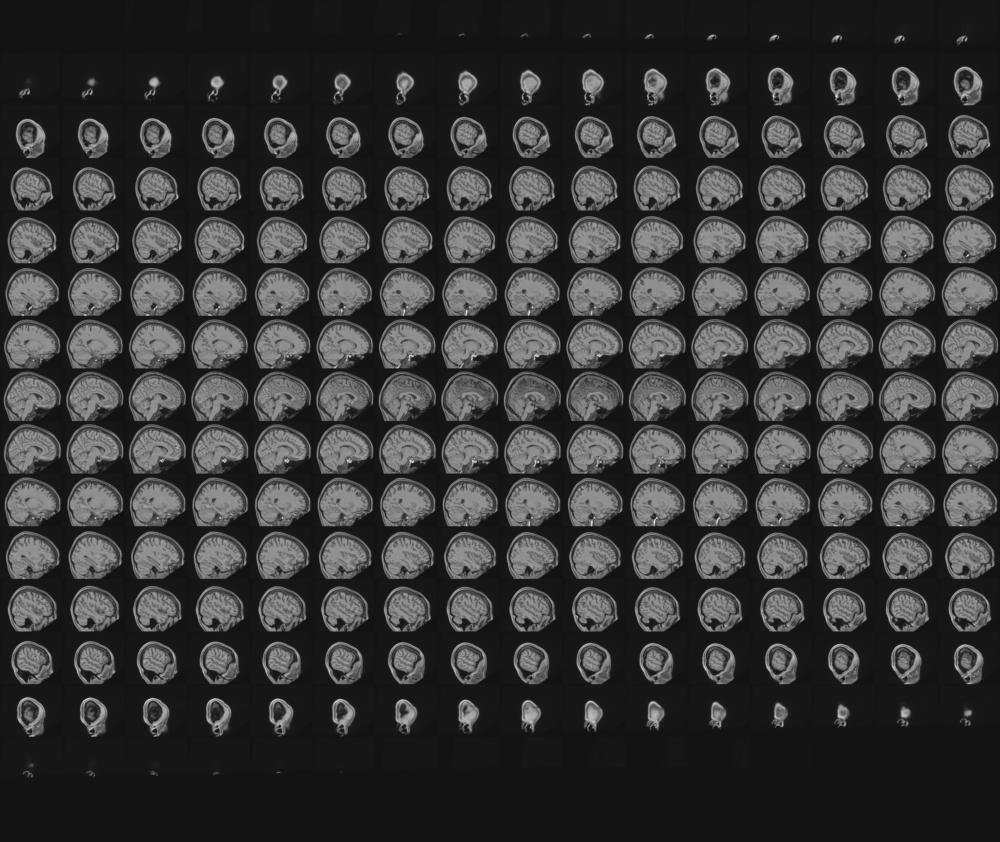
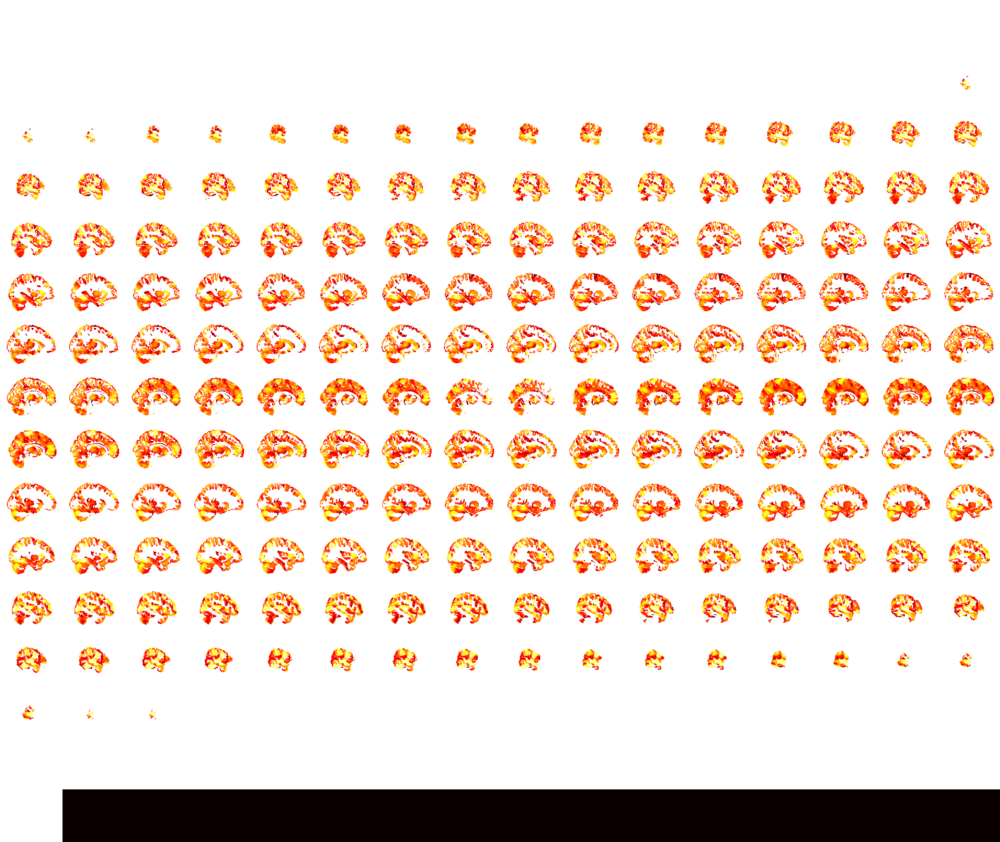

In [2]:
from nilearn import plotting 
img_parcels = model.masker_.inverse_transform(np.sum(model.components_, axis=0))
plotting.view_img(img_parcels, bg_img=file_anat, cmap=cm.get_cmap('hot'), 
                  resampling_interpolation='nearest', symmetric_cmap=0, opacity=0.5, 
                  dim=-0.75)


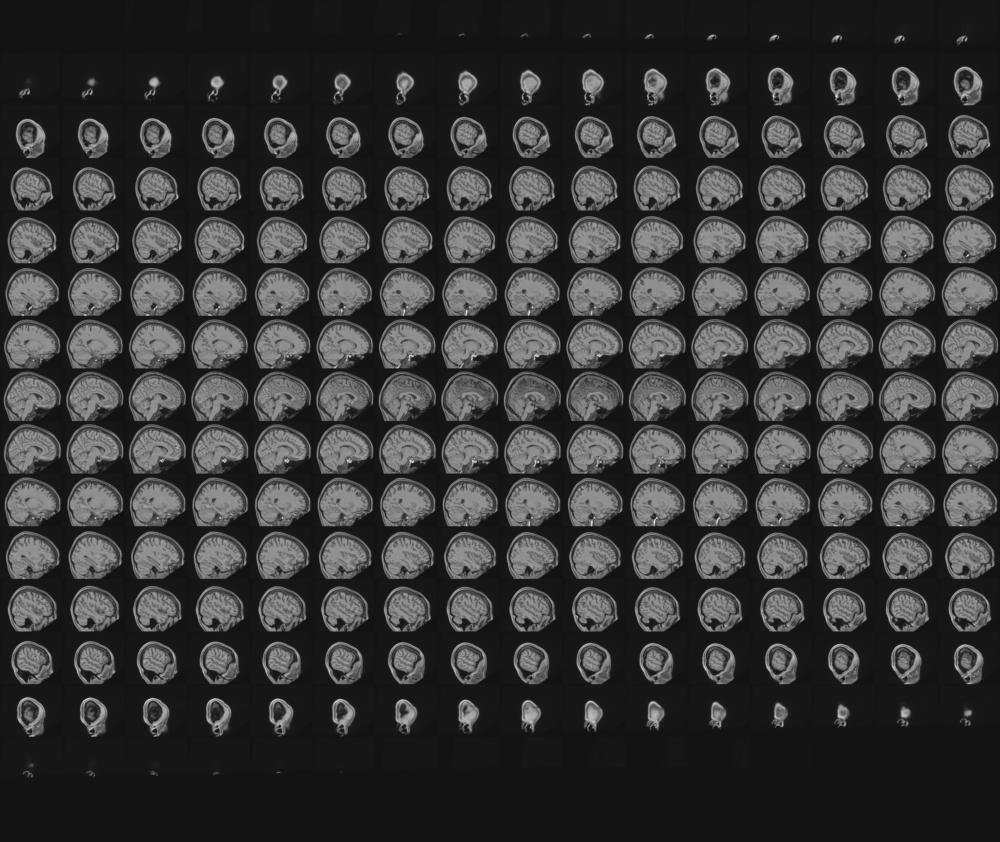
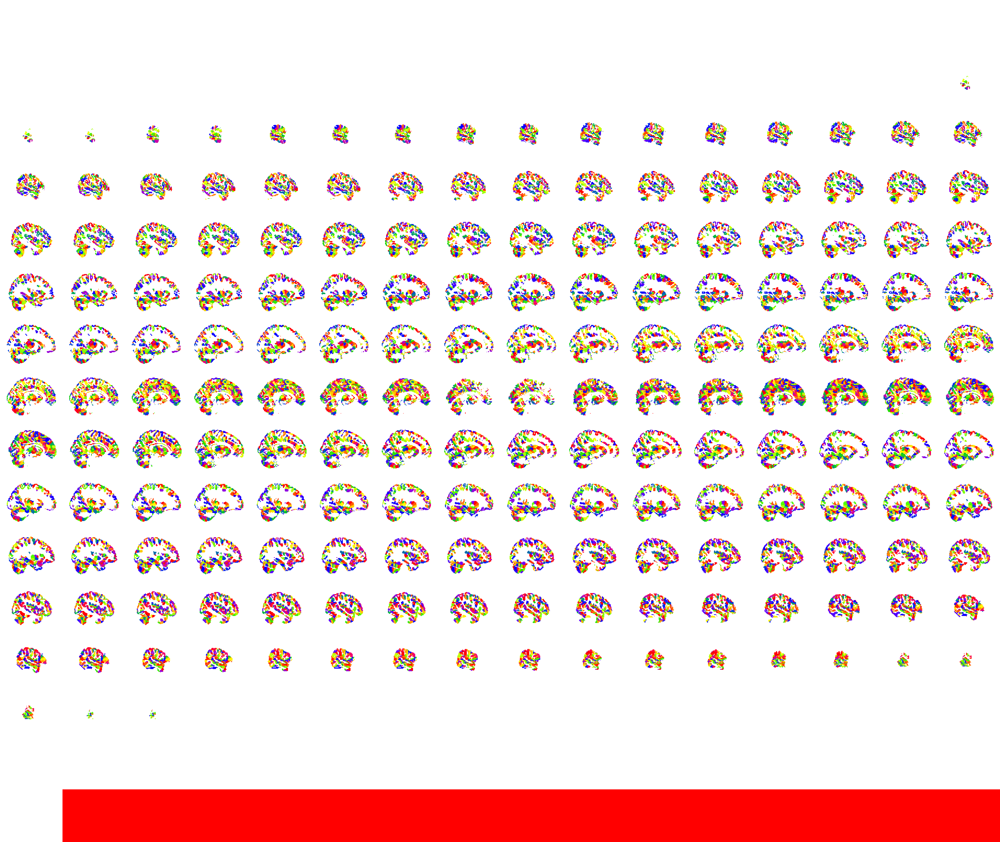

In [3]:
from nilearn import plotting 
img_parcels = model.masker_.inverse_transform(np.argmax(model.components_, axis=0))
plotting.view_img(img_parcels, bg_img=file_anat, cmap=cm.get_cmap('prism'), 
                  resampling_interpolation='nearest', symmetric_cmap=0, opacity=0.5, 
                  dim=-0.75)

In [6]:
model.components_.shape

(1023, 131536)

/home/pbellec/env/cneuromod_embeddings/lib/python3.6/site-packages/nilearn/plotting/matrix_plotting.py:13: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  ax.figure.transFigure).width
/home/pbellec/env/cneuromod_embeddings/lib/python3.6/site-packages/nilearn/plotting/matrix_plotting.py:21: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  ax.figure.transFigure).height


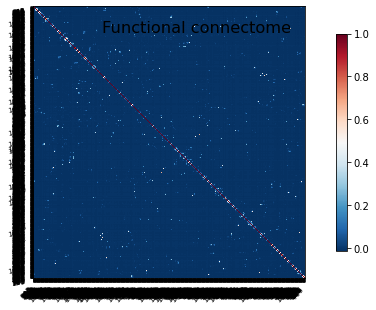

In [7]:
# We generate a parcel-to-parcel correlation 
from nilearn.connectome import ConnectivityMeasure
conn = np.squeeze(ConnectivityMeasure(kind='correlation').fit_transform([model.components_.transpose()]))

# Plot the connectome, with no particular region order
plotting.plot_matrix(conn, labels = range(1023), title='Functional connectome', reorder='average')

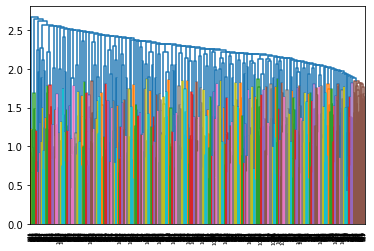

In [8]:
# we use scipy's hierarchical clustering implementation
from scipy.cluster.hierarchy import dendrogram, linkage, cut_tree
# That's the hierarchical clustering step
hier = linkage(conn, method='average', metric='euclidean') # scipy's hierarchical clustering
# HAC proceeds by iteratively merging brain regions, which can be visualized with a tree
res = dendrogram(hier, get_leaves=True) # Generate a dendrogram from the hierarchy

In [9]:
# the order of merging above give us a good order to visualize the matrix
order = res.get('leaves') # Extract the order on parcels from the dendrogram
print(order[0:10])
# here parcel 372 is the left-most leaf in the tree, then 385, etc

[976, 843, 850, 705, 306, 635, 663, 945, 254, 734]


In [15]:
# We can cut the tree at whatever number of clusters we choose (here 17, because 17 is good)
part = np.squeeze(cut_tree(hier, n_clusters=cluster)) # Cut the hierarchy
# Each entry of the vector part is a parcel, and codes for the number of the network of this parcel
print(part[0:15]) # e.g. parcel #7 is in cluster 5. What is the cluster of parcel number 10?

[ 0  1  2  2  3  4  5  6  7  8  9 10 11 12 13]


In [11]:
# Another way to represent the clusters is an adjacency matrix A # A(i,j) = 1 if i and j are in the same cluster, and 0 otherwise 
def part2adj(part): 
    part = np.reshape(part, [part.shape[0], 1])
    adj = np.repeat(part, part.shape[0], 1) == np.repeat(part.transpose(), part.shape[0], 0)
    return adj.astype(int)

(<AxesSubplot:title={'center':'part'}>,
 Text(0.5, 1.0, 'part'))

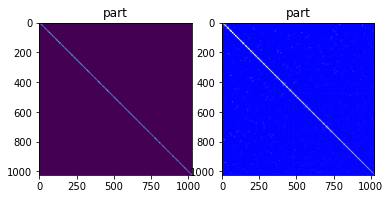

In [12]:
# Let's look at the adjacency matrix
# alongside the connectivity matrix, after reordering
plt.subplot(1,2,1), plt.imshow(part2adj(part[order])), plt.title('part')
plt.subplot(1,2,2), plt.imshow(conn[order, :][:, order], cmap='bwr'), plt.title('part')
# in the adjacency matrix, the clusters are literally squares on the diagonal!

In [16]:
for num_cluster in range(cluster):
    size_cluster = np.sum(part == num_cluster)
    print(f'{num_cluster} - {size_cluster}')

0 - 5
1 - 2
2 - 5
3 - 5
4 - 5
5 - 3
6 - 3
7 - 4
8 - 5
9 - 3
10 - 6
11 - 7
12 - 1
13 - 6
14 - 3
15 - 8
16 - 5
17 - 4
18 - 3
19 - 3
20 - 6
21 - 4
22 - 6
23 - 4
24 - 4
25 - 2
26 - 5
27 - 3
28 - 2
29 - 3
30 - 4
31 - 5
32 - 4
33 - 4
34 - 3
35 - 6
36 - 4
37 - 5
38 - 6
39 - 3
40 - 3
41 - 5
42 - 2
43 - 3
44 - 4
45 - 2
46 - 4
47 - 4
48 - 3
49 - 6
50 - 2
51 - 4
52 - 3
53 - 5
54 - 2
55 - 3
56 - 6
57 - 7
58 - 2
59 - 5
60 - 4
61 - 3
62 - 2
63 - 5
64 - 2
65 - 4
66 - 2
67 - 3
68 - 4
69 - 5
70 - 4
71 - 2
72 - 5
73 - 2
74 - 4
75 - 5
76 - 3
77 - 4
78 - 4
79 - 4
80 - 6
81 - 3
82 - 5
83 - 7
84 - 5
85 - 3
86 - 4
87 - 4
88 - 3
89 - 7
90 - 4
91 - 3
92 - 4
93 - 3
94 - 5
95 - 4
96 - 3
97 - 6
98 - 2
99 - 5
100 - 8
101 - 5
102 - 5
103 - 5
104 - 5
105 - 3
106 - 4
107 - 8
108 - 5
109 - 5
110 - 3
111 - 4
112 - 3
113 - 4
114 - 6
115 - 4
116 - 5
117 - 3
118 - 5
119 - 3
120 - 3
121 - 5
122 - 6
123 - 5
124 - 4
125 - 3
126 - 2
127 - 2
128 - 3
129 - 3
130 - 5
131 - 2
132 - 4
133 - 6
134 - 4
135 - 4
136 - 7
137 - 5
138 - 

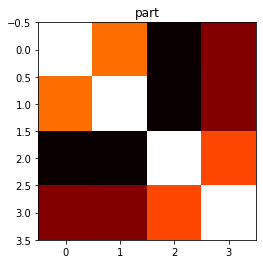

In [261]:
num_cluster = 240
# cerebellar parcels 
# num_cluster = 45
# putamen parcels
# num_cluster = 42
# cerebellum parcels
# num_cluster = 19
# parietal (dorsal stream) parcels 
# num_cluster = 107
# visual (?) parcels
# num_cluster = 100 
# parietal parcels 
# num_cluster = 83
# cingular cortex parcels
# num_cluster = 72
# primary visual parcels 
# num_cluster = 49
# more visual parcels 
# num_cluster = 63
# sensorimotor parcels
# num_cluster = 38
# some high level visual (?) parcels
# num_cluster = 10
# Very cool motor regions
# num_cluster = 214
# noise (cardiac?)
# num_cluster = 217
plt.imshow(conn[part == num_cluster, :][:, part == num_cluster], cmap='hot', vmin=0, vmax=1), plt.title('part')
indices = np.nonzero([part == num_cluster])[1]

/home/pbellec/env/cneuromod_embeddings/lib/python3.6/site-packages/nilearn/reporting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



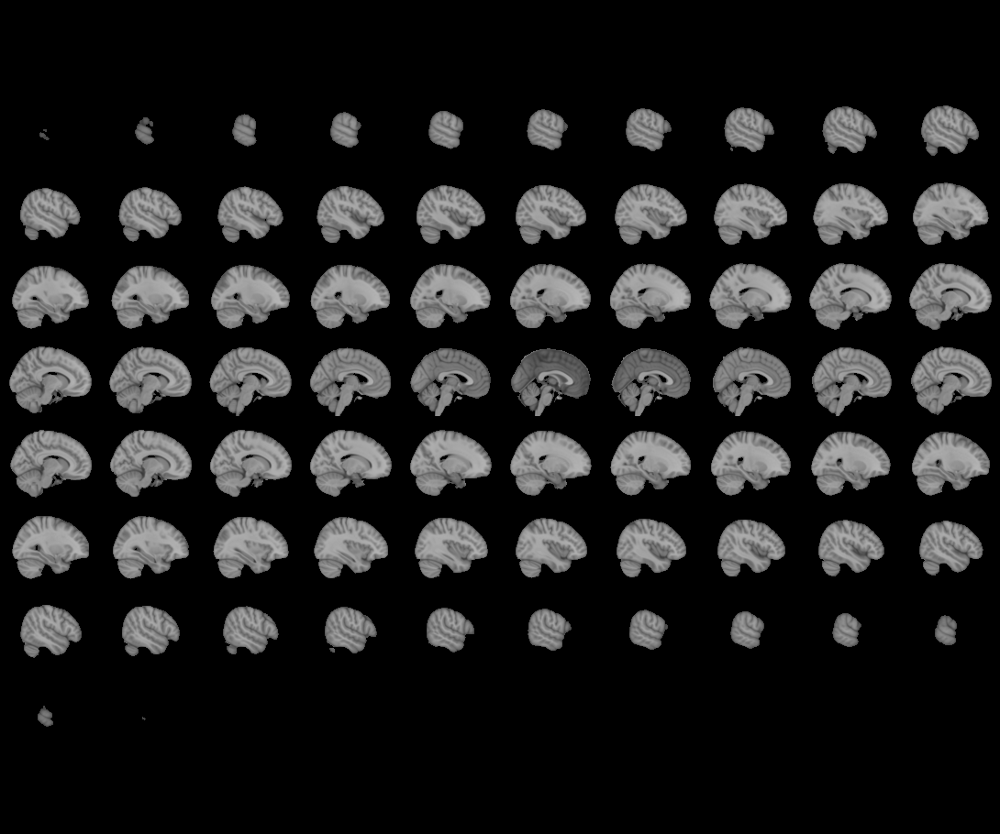
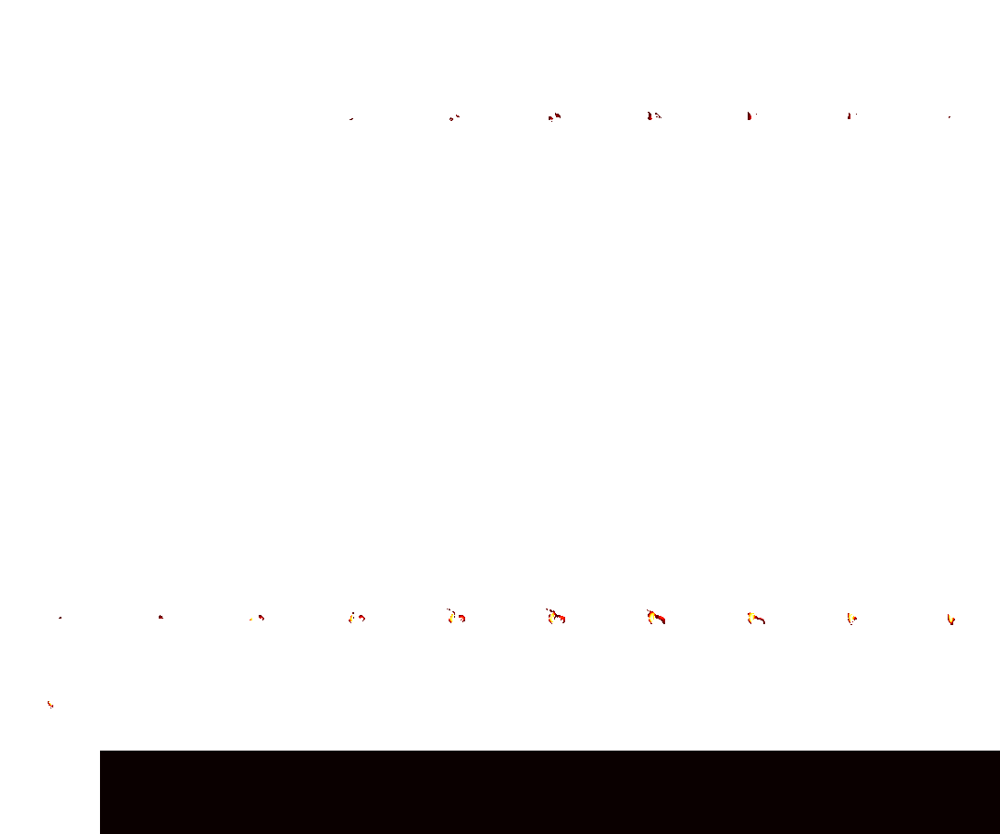

In [260]:
img_parcels = model.masker_.inverse_transform(model.components_[indices[0], :])
plotting.view_img(
    img_parcels, 
    resampling_interpolation='nearest', 
    cmap='hot', 
    threshold=0.1, 
    symmetric_cmap=0, 
    opacity=0.5, 
    vmax=1
)

/home/pbellec/env/cneuromod_embeddings/lib/python3.6/site-packages/nilearn/reporting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



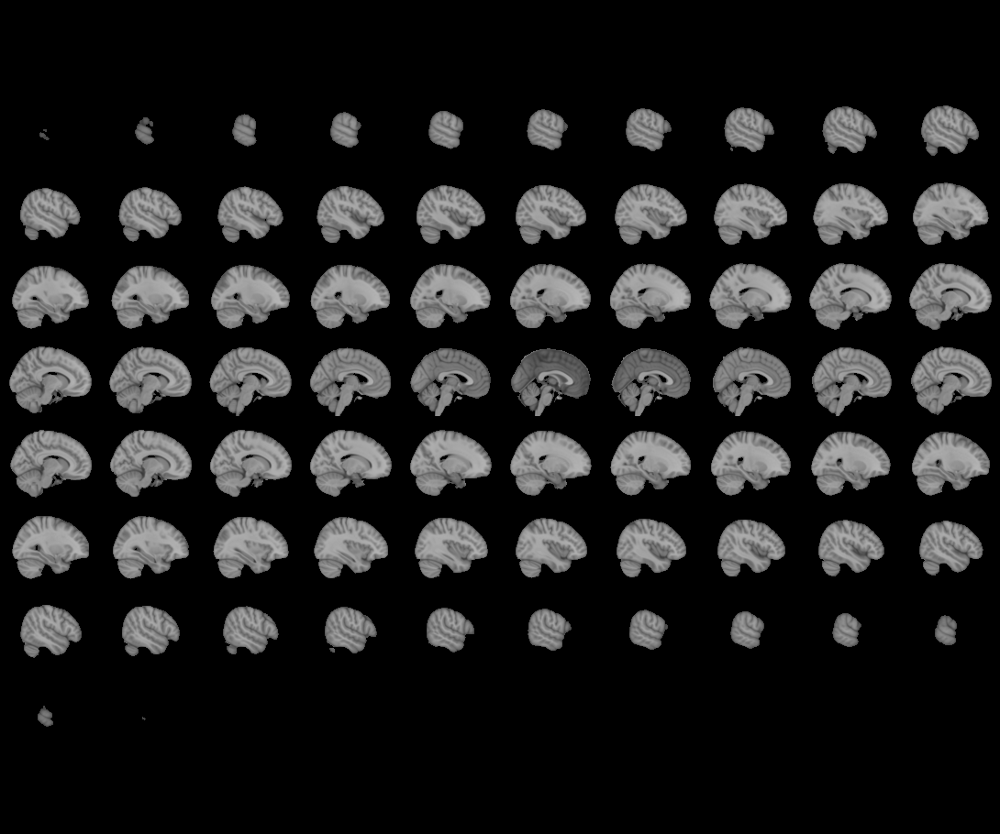
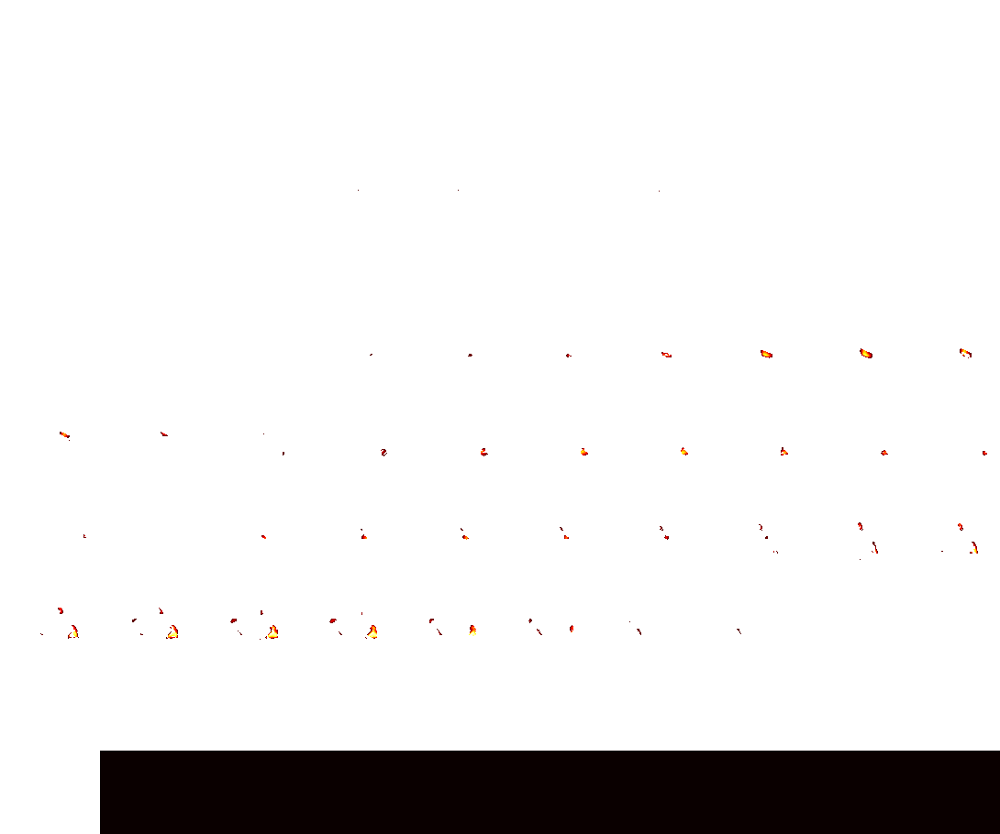

In [256]:
img_parcels = model.masker_.inverse_transform(model.components_[indices[1], :])
plotting.view_img(
    img_parcels, 
    resampling_interpolation='nearest', 
    cmap='hot', 
    threshold=0.1, 
    symmetric_cmap=0, 
    opacity=0.5, 
    vmax=1
)

/home/pbellec/env/cneuromod_embeddings/lib/python3.6/site-packages/nilearn/reporting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



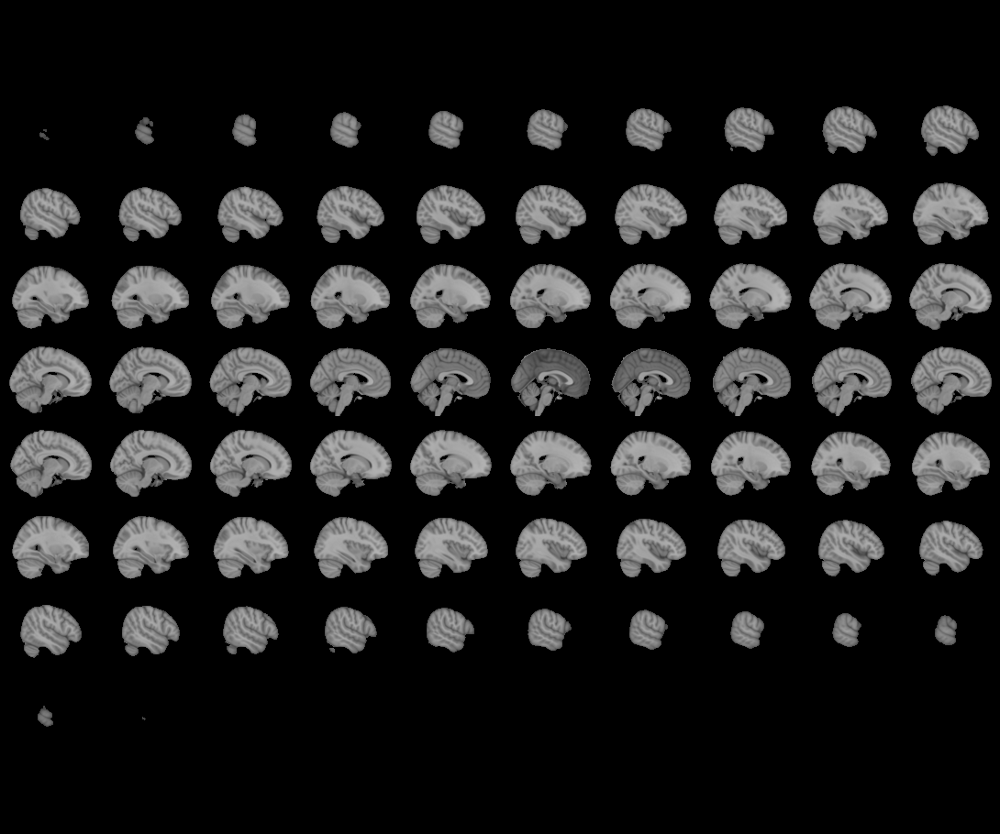
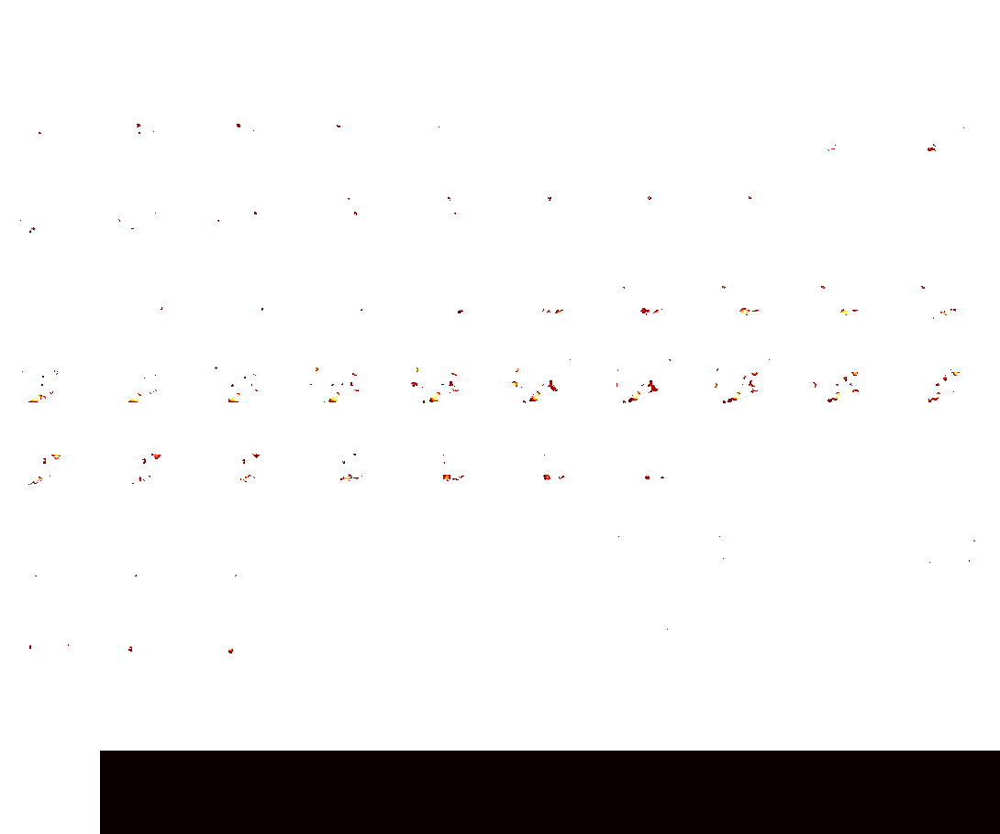

In [253]:
img_parcels = model.masker_.inverse_transform(model.components_[indices[2], :])
plotting.view_img(
    img_parcels, 
    resampling_interpolation='nearest', 
    cmap='hot', 
    threshold=0.1, 
    symmetric_cmap=0, 
    opacity=0.5, 
    vmax=1
)

/home/pbellec/env/cneuromod_embeddings/lib/python3.6/site-packages/nilearn/reporting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



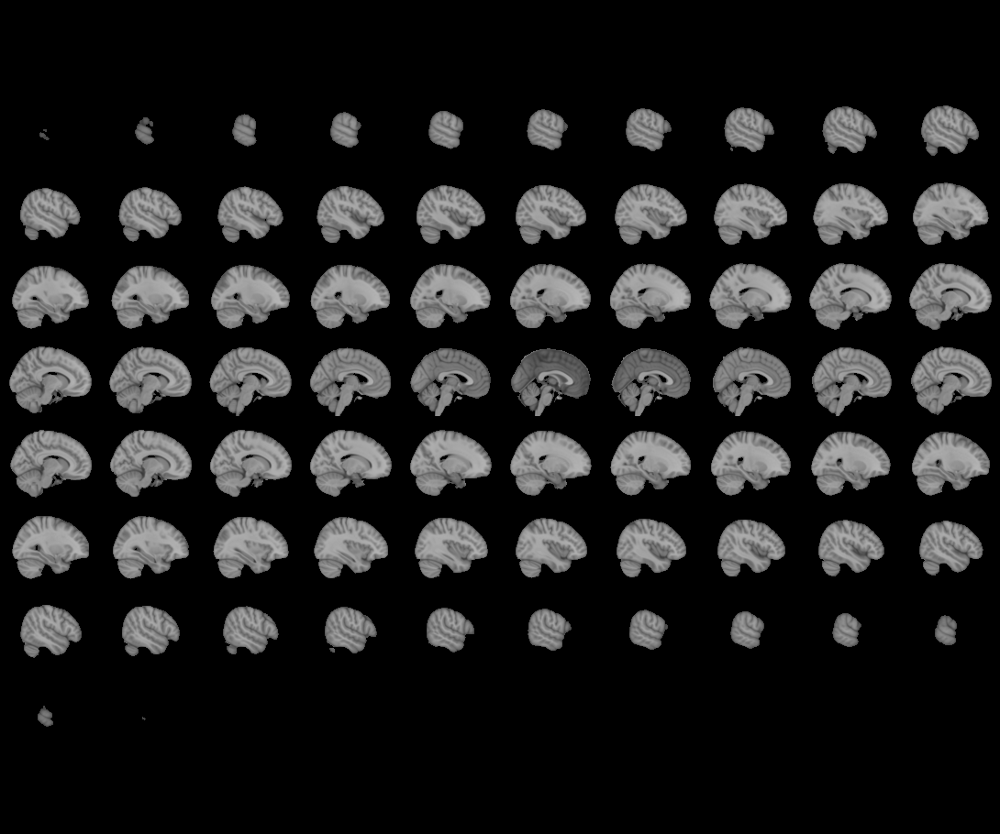
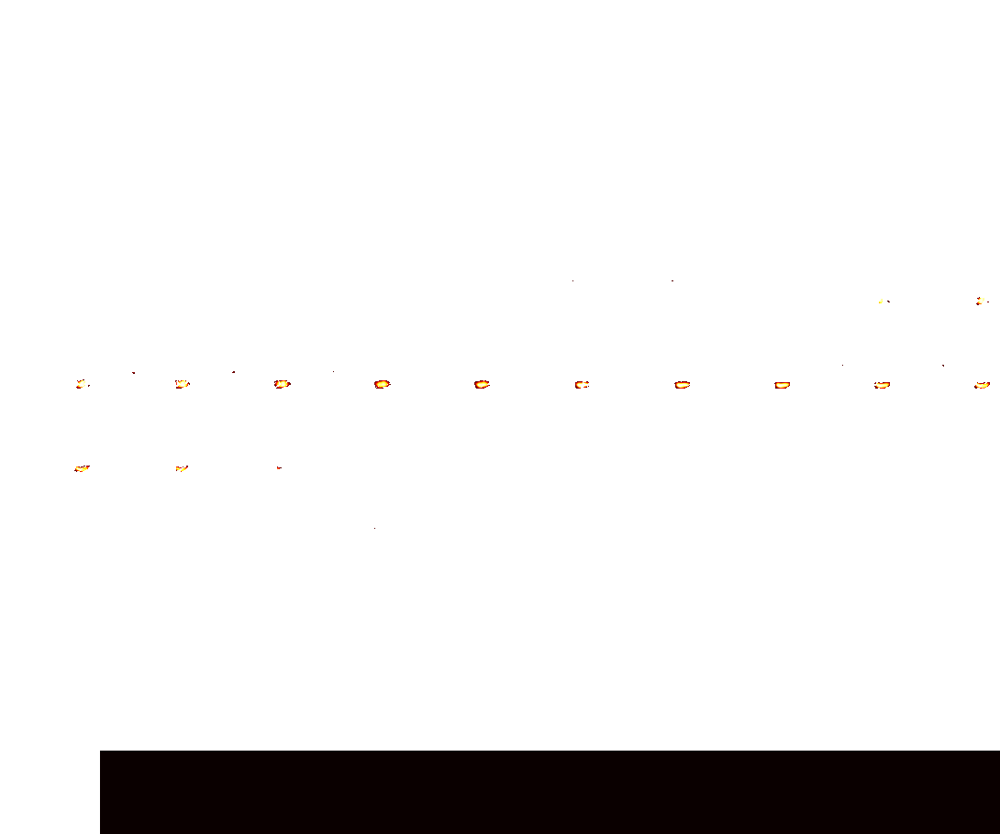

In [247]:
img_parcels = model.masker_.inverse_transform(model.components_[indices[3], :])
plotting.view_img(
    img_parcels, 
    resampling_interpolation='nearest', 
    cmap='hot', 
    threshold=0.1, 
    symmetric_cmap=0, 
    opacity=0.5, 
    vmax=1
)

/home/pbellec/env/cneuromod_embeddings/lib/python3.6/site-packages/nilearn/reporting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



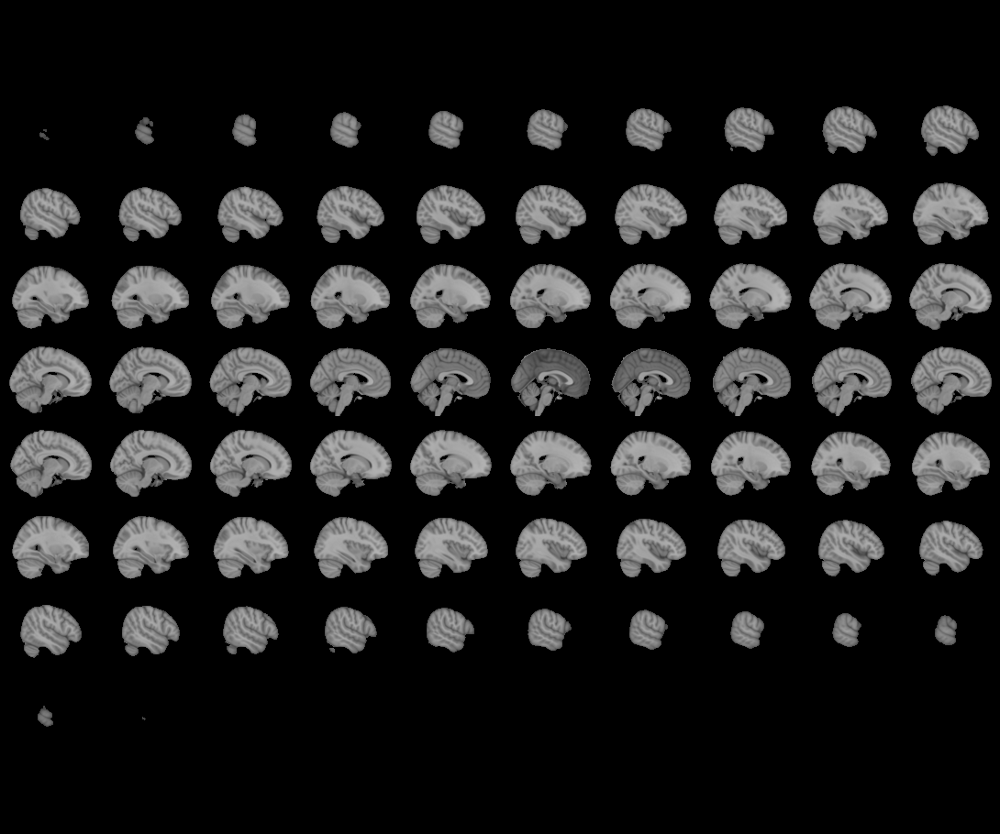
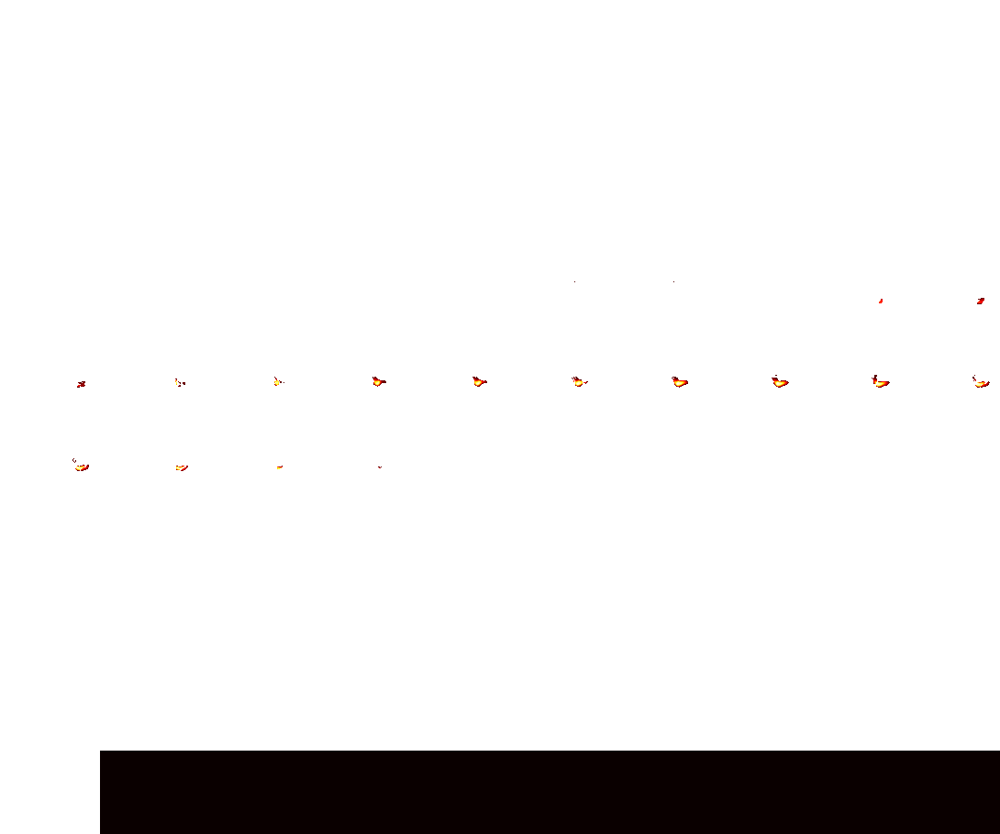

In [248]:
img_parcels = model.masker_.inverse_transform(model.components_[indices[4], :])
plotting.view_img(
    img_parcels, 
    resampling_interpolation='nearest', 
    cmap='hot', 
    threshold=0.1, 
    symmetric_cmap=0, 
    opacity=0.5, 
    vmax=1
)

/home/pbellec/env/cneuromod_embeddings/lib/python3.6/site-packages/nilearn/reporting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



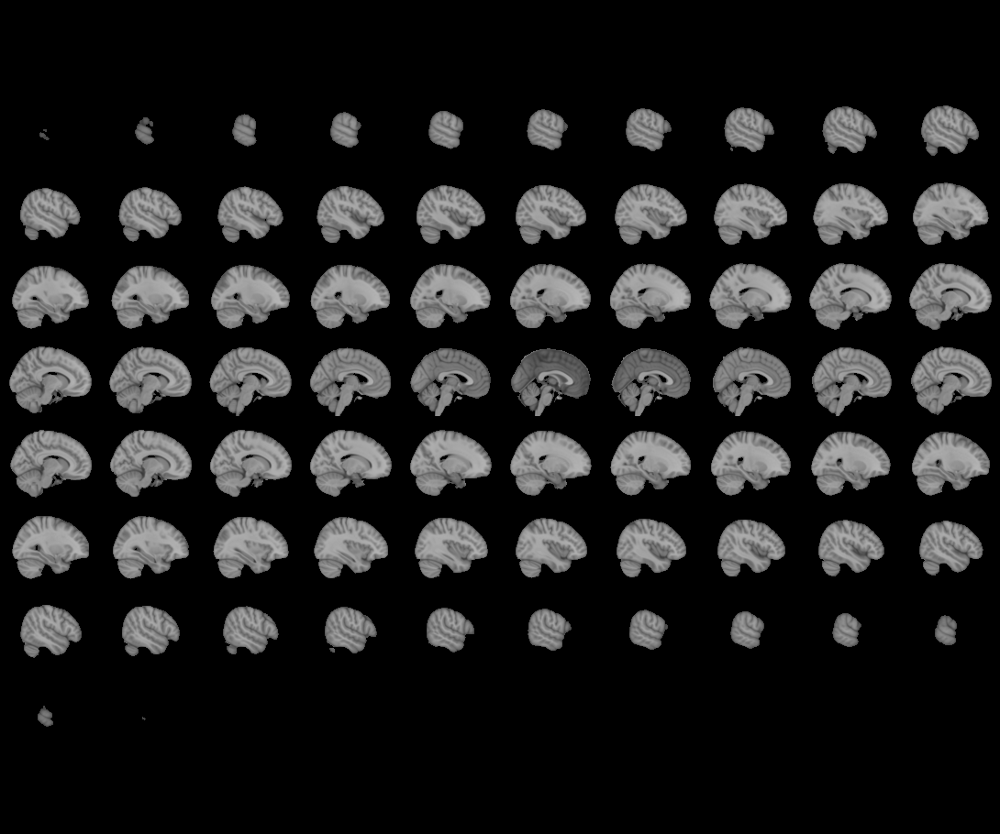
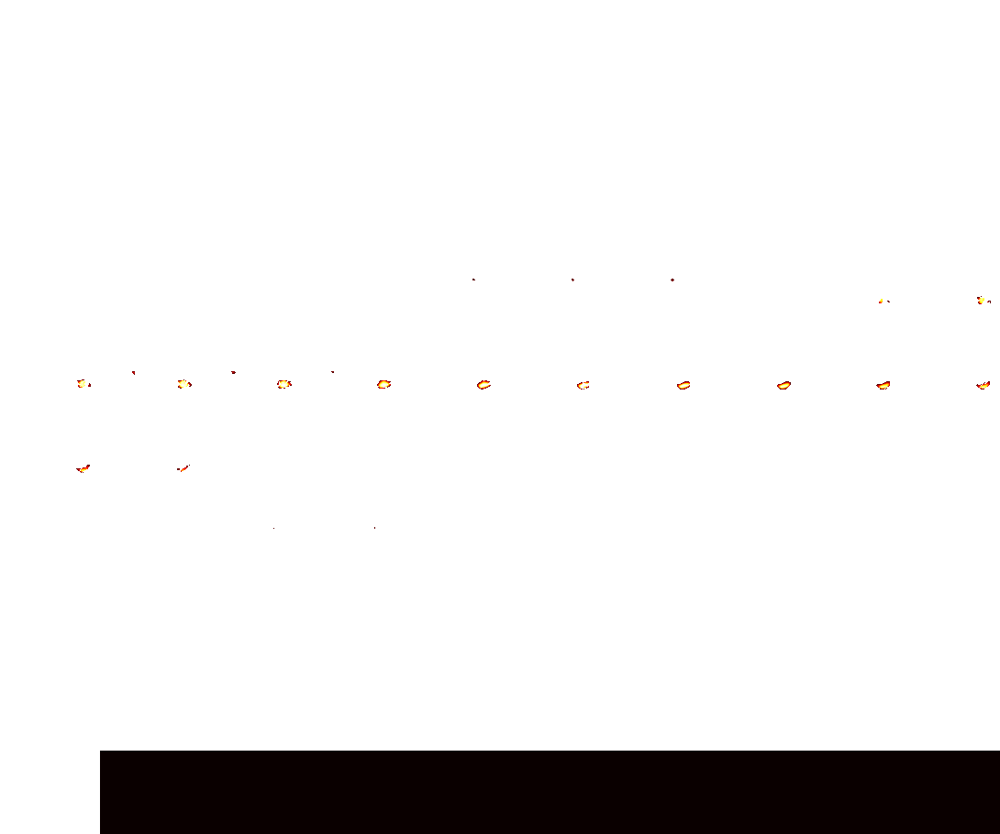

In [249]:
img_parcels = model.masker_.inverse_transform(model.components_[indices[5], :])
plotting.view_img(
    img_parcels, 
    resampling_interpolation='nearest', 
    cmap='hot', 
    threshold=0.1, 
    symmetric_cmap=0, 
    opacity=0.5, 
    vmax=1
)

/home/pbellec/env/cneuromod_embeddings/lib/python3.6/site-packages/nilearn/reporting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



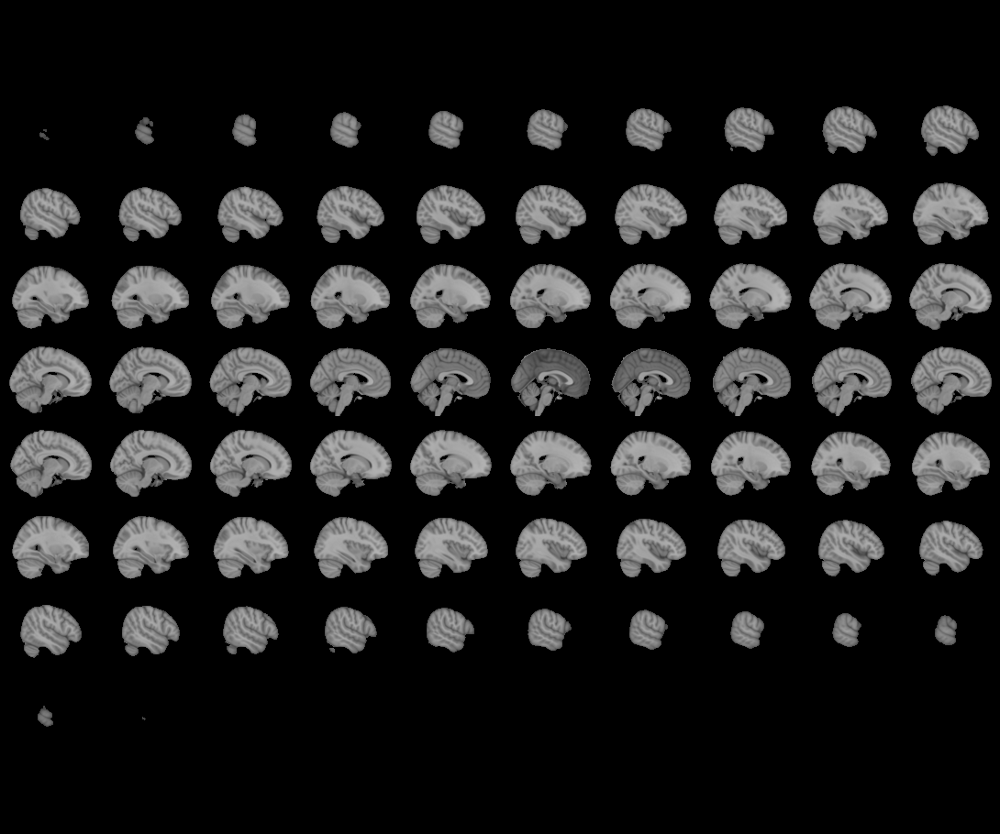
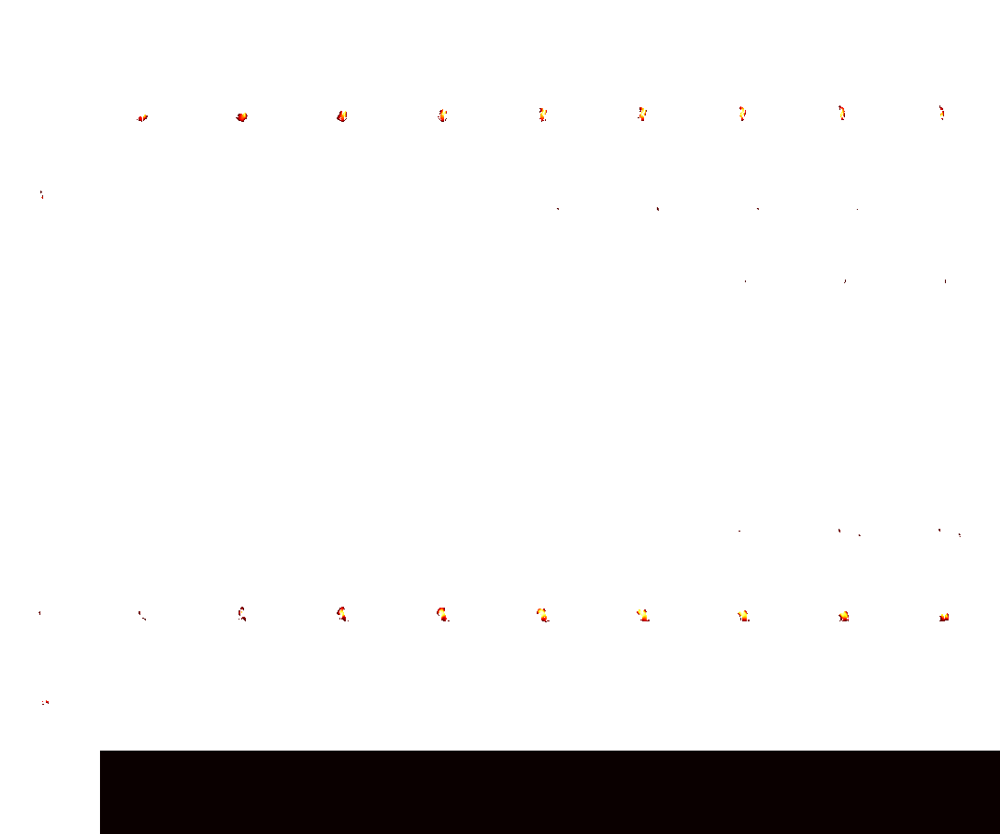

In [143]:
img_parcels = model.masker_.inverse_transform(model.components_[indices[6], :])
plotting.view_img(
    img_parcels, 
    resampling_interpolation='nearest', 
    cmap='hot', 
    threshold=0.1, 
    symmetric_cmap=0, 
    opacity=0.5, 
    vmax=1
)

In [144]:
img_parcels = model.masker_.inverse_transform(model.components_[indices[7], :])
plotting.view_img(
    img_parcels, 
    resampling_interpolation='nearest', 
    cmap='hot', 
    threshold=0.1, 
    symmetric_cmap=0, 
    opacity=0.5, 
    vmax=1
)

IndexError: index 7 is out of bounds for axis 0 with size 7